In [ ]:
!pip install -U pandas-profiling[notebook]
!jupyter nbextension enable --py widgetsnbextension

In [ ]:
import pandas as pd
import numpy as np
import folium
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
from pylab import rcParams
import statsmodels.api as sm
import matplotlib
import itertools

In [ ]:
df = pd.read_csv('sensors.csv')
df.head()

,created_at,PM1.0_CF1_ug/m3,PM2.5_CF1_ug/m3,PM10.0_CF1_ug/m3,UptimeMinutes,ADC,Pressure_hpa,PM2.5_ATM_ug/m3,>=0.3um/dl,>=0.5um/dl,>1.0um/dl,>=2.5um/dl,>=5.0um/dl,>=10.0um/dl,lat,long,sensor,RSSI_dbm,Temperature_F,Humidity_%,PM1.0_ATM_ug/m3,PM10_ATM_ug/m3
0,2021-01-01 00:00:00 UTC,0.24,0.88,1.74,18139.20,0.02,1019.76,0.88,214.18,62.73,12.31,2.73,1.31,0.27,-33.847175,151.210579,Milson,NaN,NaN,NaN,NaN,NaN
1,2021-01-01 00:30:00 UTC,0.13,0.73,1.44,18131.73,0.02,1019.62,0.73,187.86,54.64,10.54,2.83,1.17,0.21,-33.847175,151.210579,Milson,NaN,NaN,NaN,NaN,NaN
2,2021-01-01 01:00:00 UTC,0.04,0.50,0.93,18116.80,0.02,1019.64,0.50,154.70,44.78,7.84,2.38,0.53,0.04,-33.847175,151.210579,Milson,NaN,NaN,NaN,NaN,NaN
3,2021-01-01 01:30:00 UTC,0.37,1.17,2.01,18128.00,0.02,1019.40,1.17,259.11,74.87,13.35,3.25,1.32,0.16,-33.847175,151.210579,Milson,NaN,NaN,NaN,NaN,NaN
4,2021-01-01 02:00:00 UTC,0.18,0.80,1.32,18083.20,0.02,1019.27,0.80,194.20,56.71,10.83,2.43,0.65,0.15,-33.847175,151.210579,Milson,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53641 entries, 0 to 53640
Data columns (total 22 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   created_at        53641 non-null  object 
 1   PM1.0_CF1_ug/m3   53324 non-null  float64
 2   PM2.5_CF1_ug/m3   53324 non-null  float64
 3   PM10.0_CF1_ug/m3  53324 non-null  float64
 4   UptimeMinutes     53324 non-null  float64
 5   ADC               26334 non-null  float64
 6   Pressure_hpa      24446 non-null  float64
 7   PM2.5_ATM_ug/m3   53324 non-null  float64
 8   >=0.3um/dl        52620 non-null  float64
 9   >=0.5um/dl        52620 non-null  float64
 10  >1.0um/dl         52620 non-null  float64
 11  >=2.5um/dl        52620 non-null  float64
 12  >=5.0um/dl        52620 non-null  float64
 13  >=10.0um/dl       52620 non-null  float64
 14  lat               53641 non-null  float64
 15  long              53641 non-null  float64
 16  sensor            53641 non-null  object

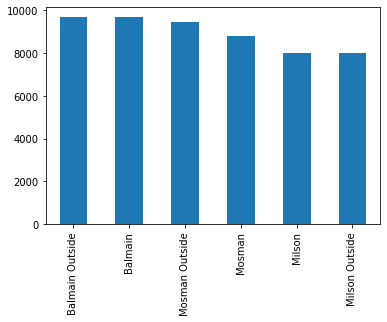

In [ ]:
df.sensor.value_counts().plot.bar()
plt.show()

In [ ]:
profile = ProfileReport(df, title="Pandas Profiling Report", explorative=True)
profile

Summarize dataset:   0%|          | 0/35 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

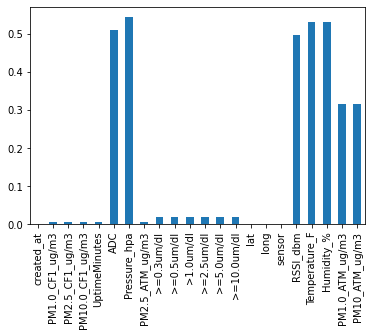

In [ ]:
(df.isnull().sum() / len(df)).plot.bar()
plt.show()

In [ ]:
value_vars = ['PM1.0_CF1_ug/m3', 'PM2.5_CF1_ug/m3', 'PM10.0_CF1_ug/m3', 'ADC', 'Pressure_hpa', 'PM2.5_ATM_ug/m3', '>=0.3um/dl',
       '>=0.5um/dl', '>1.0um/dl', '>=2.5um/dl', '>=5.0um/dl', '>=10.0um/dl',
       'PM1.0_ATM_ug/m3', 'PM10_ATM_ug/m3',
       'RSSI_dbm', 'Temperature_F', 'Humidity_%']
df_melted = df.melt(id_vars=['sensor', 'created_at'], value_vars=value_vars, var_name="Param", value_name="Value")

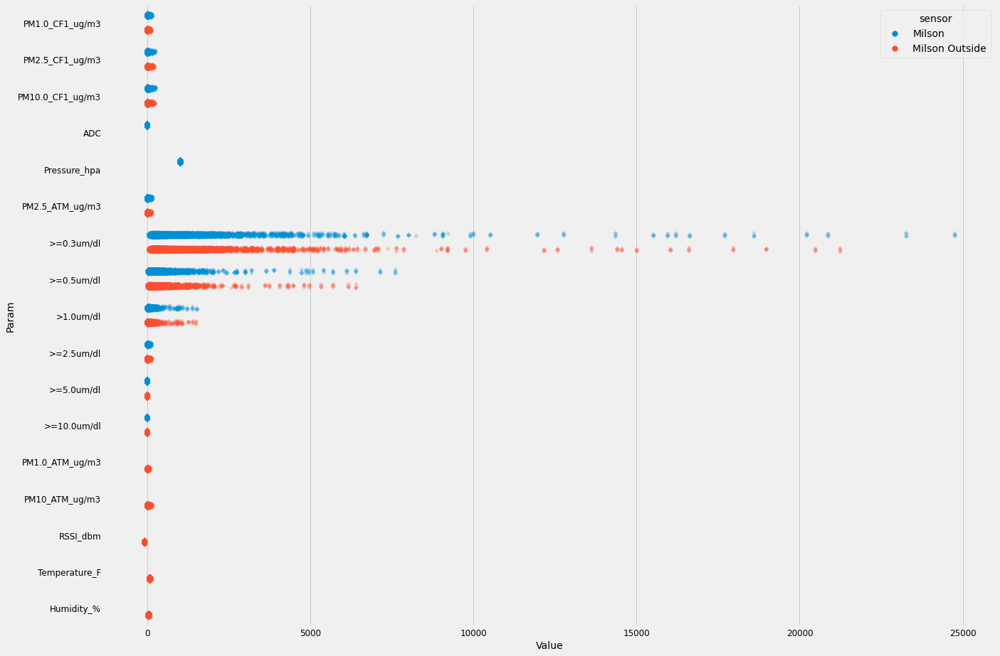

In [ ]:
fig_dims = (20, 15)
fig, ax = plt.subplots(figsize=fig_dims)
sns.stripplot(y = 'Param', x = 'Value', data = df_melted[df_melted.sensor.isin(['Milson', 'Milson Outside'])], jitter = True, marker = 'D', dodge = True, alpha = 0.25, hue = 'sensor', ax = ax)
plt.show()

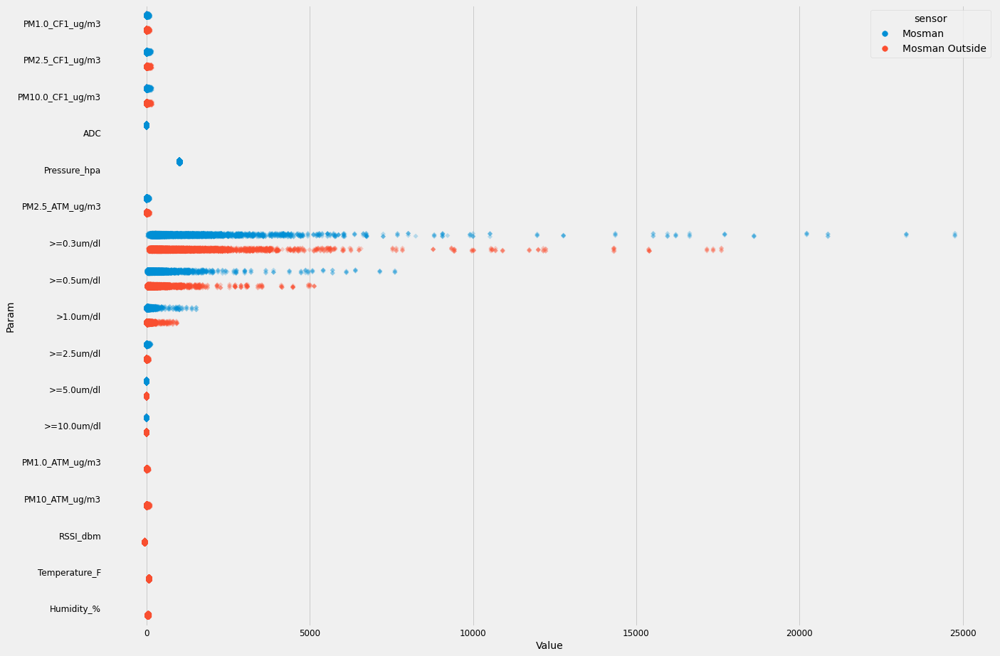

In [ ]:
fig_dims = (20, 15)
fig, ax = plt.subplots(figsize=fig_dims)
sns.stripplot(y = 'Param', x = 'Value', data = df_melted[df_melted.sensor.isin(['Mosman', 'Mosman Outside'])], jitter = True, marker = 'D', dodge = True, alpha = 0.25, hue = 'sensor', ax = ax)
plt.show()

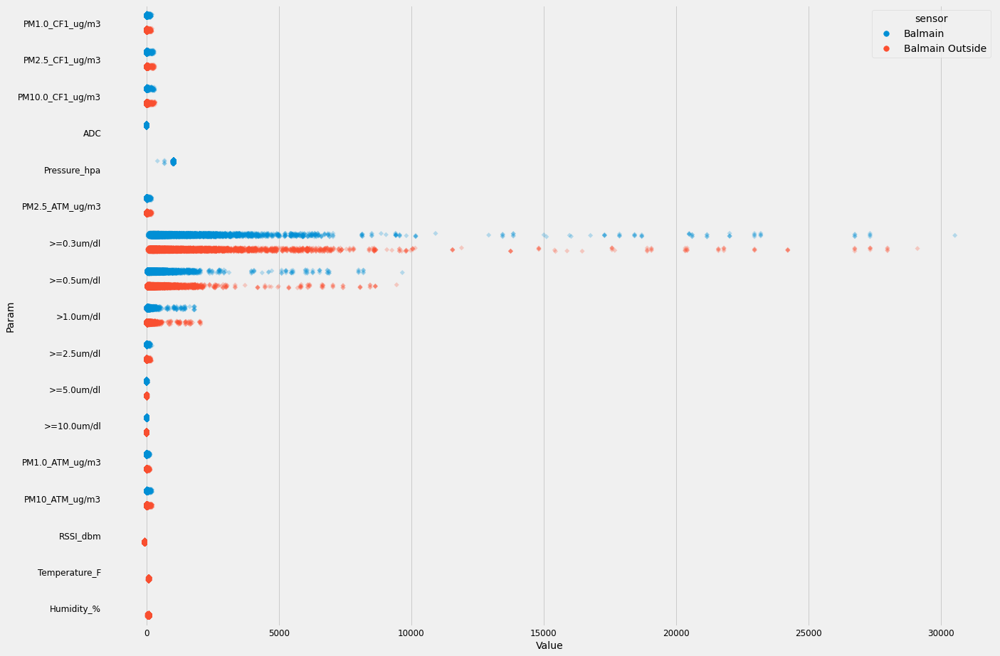

In [ ]:
fig_dims = (20, 15)
fig, ax = plt.subplots(figsize=fig_dims)
sns.stripplot(y = 'Param', x = 'Value', data = df_melted[df_melted.sensor.isin(['Balmain', 'Balmain Outside'])], jitter = True, marker = 'D', dodge = True, alpha = 0.25, hue = 'sensor', ax = ax)
plt.show()

In [ ]:
df_gb = df.groupby(['sensor', 'lat', 'long']).mean().reset_index()
df_gb.head()

,sensor,lat,long,PM1.0_CF1_ug/m3,PM2.5_CF1_ug/m3,PM10.0_CF1_ug/m3,UptimeMinutes,ADC,Pressure_hpa,PM2.5_ATM_ug/m3,>=0.3um/dl,>=0.5um/dl,>1.0um/dl,>=2.5um/dl,>=5.0um/dl,>=10.0um/dl,RSSI_dbm,Temperature_F,Humidity_%,PM1.0_ATM_ug/m3,PM10_ATM_ug/m3,anomaly_pc2
0,Balmain,-33.860263,151.182855,5.607580,8.638273,9.928383,18317.854550,0.059981,1013.956255,7.907030,1140.934529,323.504409,52.445896,6.755735,2.091662,0.363237,NaN,NaN,NaN,5.107262,9.327212,0.096934
1,Balmain Outside,-33.860263,151.182855,6.361603,9.116371,10.361602,14958.309859,NaN,NaN,8.278141,1249.418287,361.181815,54.874936,6.076181,1.678433,0.321399,-76.270781,75.600508,89.586046,5.717708,9.673259,0.112419
2,Milson,-33.847175,151.210579,5.212612,8.249505,9.133509,18350.518660,0.020311,1015.663990,7.535317,1043.102371,310.864160,47.585023,6.193154,1.178378,0.177995,NaN,NaN,NaN,NaN,NaN,0.088136
3,Milson Outside,-33.847175,151.210579,4.968740,7.542510,8.095359,13782.565210,NaN,NaN,6.936314,1053.074405,304.020001,46.088458,3.699092,0.757133,0.146575,-80.822663,76.611699,49.986203,4.590130,7.616212,0.083385
4,Mosman,-33.832318,151.245973,4.365241,6.816352,7.979569,18546.304802,0.019071,1008.915065,6.359119,1043.837865,311.083091,47.616261,6.196722,1.178836,0.178043,NaN,NaN,NaN,NaN,NaN,0.066061


In [ ]:
df_gb_loc = df.groupby(['lat', 'long']).mean().reset_index()

In [ ]:
df_gb_loc.head()

,lat,long,PM1.0_CF1_ug/m3,PM2.5_CF1_ug/m3,PM10.0_CF1_ug/m3,UptimeMinutes,ADC,Pressure_hpa,PM2.5_ATM_ug/m3,>=0.3um/dl,>=0.5um/dl,>1.0um/dl,>=2.5um/dl,>=5.0um/dl,>=10.0um/dl,RSSI_dbm,Temperature_F,Humidity_%,PM1.0_ATM_ug/m3,PM10_ATM_ug/m3,anomaly_pc2
0,-33.860263,151.182855,5.984611,8.877334,10.145003,16637.995408,0.059981,1013.956255,8.092595,1195.176408,342.343112,53.660416,6.415958,1.885048,0.342318,-76.270781,75.600508,89.586046,5.412485,9.500236,0.104676
1,-33.847175,151.210579,5.090661,7.895964,8.614369,16066.255937,0.020311,1015.663990,7.235778,1048.088700,307.441866,46.836694,4.946045,0.967743,0.162284,-80.822663,76.611699,49.986203,4.590130,7.616212,0.085761
2,-33.832318,151.245973,4.474199,6.985513,8.202019,16768.665514,0.019071,1008.915065,6.521756,1012.204440,292.325278,45.923880,6.191033,1.352822,0.613744,-57.582646,75.657171,50.753154,4.244773,8.043099,0.067053


In [ ]:
df_gb_loc[df_gb_loc.lat == -33.832318]['PM2.5_CF1_ug/m3'][2]*10

69.85513084060189

In [ ]:
m=folium.Map(location=[-33.8559799094,151.20666584], zoom_start=13)
folium.CircleMarker(location=[-33.860263,151.182855], radius=df_gb_loc[df_gb_loc.lat == -33.860263]['PM2.5_CF1_ug/m3'][0]*10, popup="Balmain", color="#3186cc", fill=True, fill_color="#3186cc").add_to(m)
folium.CircleMarker(location=[-33.847175,151.210579], radius=df_gb_loc[df_gb_loc.lat == -33.847175]['PM2.5_CF1_ug/m3'][1]*10, popup="Milsons", color="crimson", fill=True, fill_color="crimson").add_to(m)
folium.CircleMarker(location=[-33.832318,151.245973	], radius=df_gb_loc[df_gb_loc.lat == -33.832318]['PM2.5_CF1_ug/m3'][2]*10, popup="Mosman", color="teal", fill=True, fill_color="teal").add_to(m)
m

In [ ]:
m1=folium.Map(location=[-33.860263,151.182855], zoom_start=17)
folium.CircleMarker(location=[-33.860263,151.182855], radius=df_gb_loc[df_gb_loc.lat == -33.860263]['PM2.5_CF1_ug/m3'][0]*10, popup="Balmain", color="#3186cc", fill=True, fill_color="#3186cc").add_to(m1)
m1

In [ ]:
m2=folium.Map(location=[-33.847175,151.210579], zoom_start=17)
folium.CircleMarker(location=[-33.847175,151.210579], radius=df_gb_loc[df_gb_loc.lat == -33.847175]['PM2.5_CF1_ug/m3'][1]*10, popup="Milsons", color="crimson", fill=True, fill_color="crimson").add_to(m2)
m2

In [ ]:
m3=folium.Map(location=[-33.832318,151.245973	], zoom_start=17)
folium.CircleMarker(location=[-33.832318,151.245973	], radius=df_gb_loc[df_gb_loc.lat == -33.832318]['PM2.5_CF1_ug/m3'][2]*10, popup="Mosman", color="teal", fill=True, fill_color="teal").add_to(m3)
m3

In [ ]:
grouped = df.groupby(df.sensor)

Milson = grouped.get_group("Milson")
milson_df= pd.DataFrame(Milson)

drop_cols = ['RSSI_dbm','Temperature_F','Humidity_%']
milson_df.drop(drop_cols, inplace=True, axis=1)


Milson_outside = grouped.get_group("Milson Outside")
milson_outside_df = pd.DataFrame(Milson_outside)

drop_cols = ['ADC','Pressure_hpa']
milson_outside_df.drop(drop_cols, inplace=True, axis=1)


Mosman = grouped.get_group("Mosman")
mosman_df = pd.DataFrame(Mosman)

drop_cols = ['RSSI_dbm','Temperature_F','Humidity_%']
mosman_df.drop(drop_cols, inplace=True, axis=1)


mosman_outside = grouped.get_group("Mosman Outside")
mosman_outside_df = pd.DataFrame(mosman_outside)

drop_cols = ['ADC','Pressure_hpa']
mosman_outside_df.drop(drop_cols, inplace=True, axis=1)


Balmain = grouped.get_group("Balmain")
balmain_df = pd.DataFrame(Balmain)

drop_cols = ['RSSI_dbm','Temperature_F','Humidity_%']
balmain_df.drop(drop_cols, inplace=True, axis=1)




balmain_outside = grouped.get_group("Balmain Outside")
balmain_outside_df = pd.DataFrame(balmain_outside)

drop_cols = ['ADC','Pressure_hpa']
balmain_outside_df.drop(drop_cols, inplace=True, axis=1)

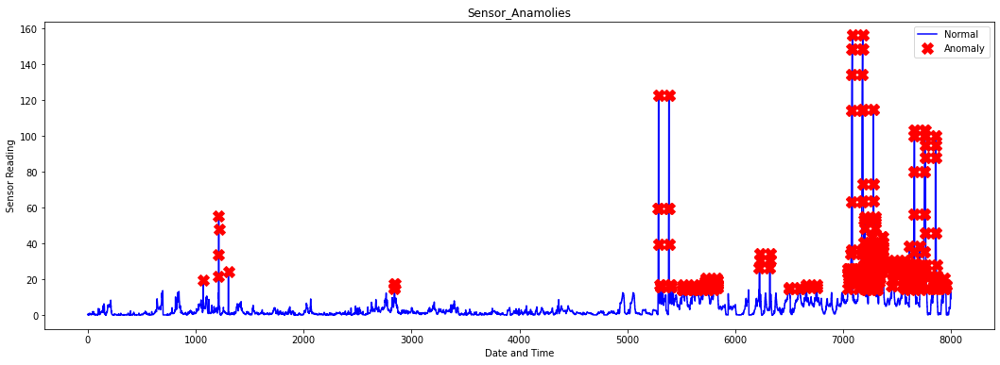

In [ ]:
df_list=[milson_df,milson_outside_df,mosman_df,mosman_outside_df,balmain_df,balmain_outside_df]

q1_pc1, q3_pc1 = milson_df['PM1.0_CF1_ug/m3'].quantile([0.25, 0.75])
iqr_pc1 = q3_pc1 - q1_pc1
# Calculate upper and lower bounds for outlier for pc1
lower_pc1 = q1_pc1 - (1.5*iqr_pc1)
upper_pc1 = q3_pc1 + (1.5*iqr_pc1)
# Filter out the outliers from the pc1
milson_df['anomaly_pc1'] = ((milson_df['PM1.0_CF1_ug/m3']>upper_pc1) | (milson_df['PM1.0_CF1_ug/m3']<lower_pc1)).astype('int')
# Calculate IQR for the 2nd principal component (pc2)
q1_pc2, q3_pc2 = milson_df['PM2.5_CF1_ug/m3'].quantile([0.25, 0.75])
iqr_pc2 = q3_pc2 - q1_pc2
# Calculate upper and lower bounds for outlier for pc2
lower_pc2 = q1_pc2 - (1.5*iqr_pc2)
upper_pc2 = q3_pc2 + (1.5*iqr_pc2)
# Filter out the outliers from the pc2
df['anomaly_pc2'] = ((df['PM2.5_CF1_ug/m3']>upper_pc2) | (df['PM2.5_CF1_ug/m3']<lower_pc2)).astype('int')
# Let's plot the outliers from pc1 on top of the sensor_11 and see where they occured in the time series
a = milson_df[milson_df['anomaly_pc1'] == 1] #anomaly
_ = plt.figure(figsize=(18,6))
_ = plt.plot(milson_df['PM1.0_CF1_ug/m3'], color='blue', label='Normal')
_ = plt.plot(a['PM1.0_CF1_ug/m3'], linestyle='none', marker='X', color='red', markersize=12, label='Anomaly')
_ = plt.xlabel('Date and Time')
_ = plt.ylabel('Sensor Reading')
_ = plt.title('Sensor_Anamolies')
_ = plt.legend(loc='best')

milson_df.drop(['anomaly_pc1'],axis=1)
plt.show();


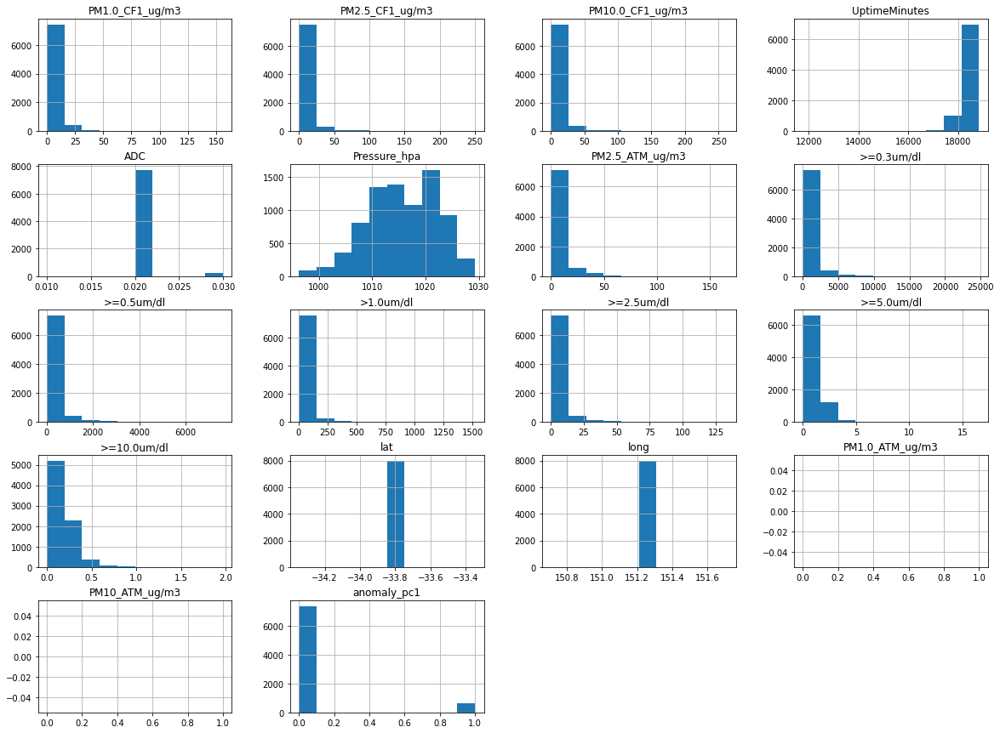

In [ ]:
milson_df.hist(bins=10, figsize = (20,15))
plt.show()

In [ ]:
for df_iter in df_list:
  num_columns= [ elem for elem in list(df_iter.columns) if elem not in ['sensor','UptimeMinutes','lat','long','created_at',"ADC"]]

  for i in num_columns:
    q1,q3=df_iter[i].quantile([0.25, 0.75])
    iqr = q3 - q1
    lower = q1 - (1.5*iqr)
    upper = q3 + (1.5*iqr)
    series_outlier = ((df_iter[i]>upper) | (df_iter[i]<lower)).astype('int').tolist()
    index_outlier=[elem for elem in range (len(series_outlier)) if series_outlier[elem]==1]
    df_iter[i].iloc[index_outlier]=np.nan

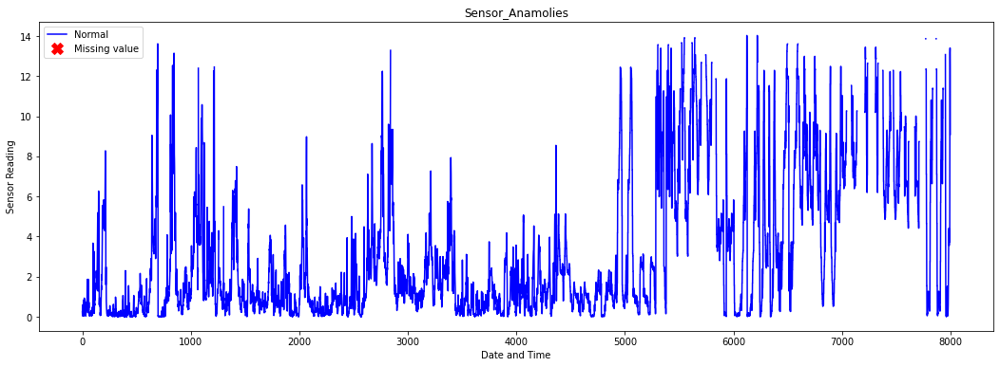

In [ ]:
a = milson_df[milson_df['PM1.0_CF1_ug/m3'] == np.nan] #anomaly
_ = plt.figure(figsize=(18,6))
_ = plt.plot(milson_df['PM1.0_CF1_ug/m3'], color='blue', label='Normal')
_ = plt.plot(a['PM1.0_CF1_ug/m3'], linestyle='none', marker='X', color='red', markersize=12, label='Missing value')
_ = plt.xlabel('Date and Time')
_ = plt.ylabel('Sensor Reading')
_ = plt.title('Sensor_Anamolies')
_ = plt.legend(loc='best')

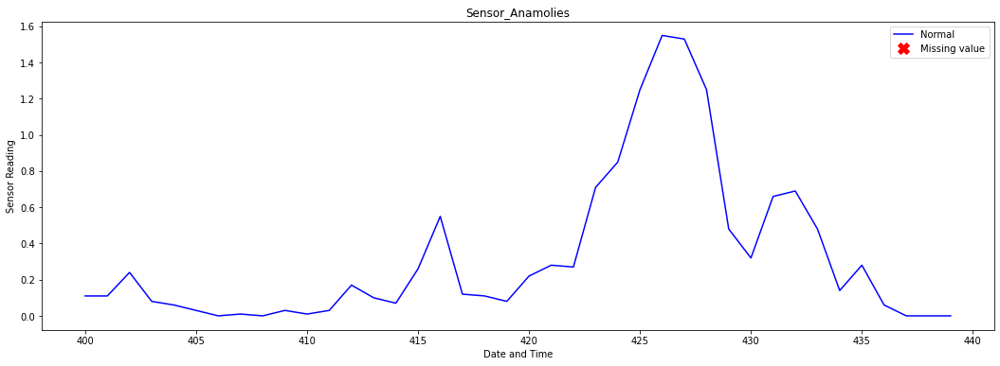

In [ ]:
a = milson_df[milson_df['PM1.0_ATM_ug/m3'] == np.nan][400:440] #anomaly
_ = plt.figure(figsize=(18,6))
_ = plt.plot(milson_df['PM1.0_CF1_ug/m3'][400:440], color='blue', label='Normal')
_ = plt.plot(a['PM1.0_CF1_ug/m3'], linestyle='none', marker='X', color='red', markersize=12, label='Missing value')
_ = plt.xlabel('Date and Time')
_ = plt.ylabel('Sensor Reading')
_ = plt.title('Sensor_Anamolies')
_ = plt.legend(loc='best')
plt.show();

In [ ]:
for df_iter in df_list:
  df_iter.index=(pd.DatetimeIndex(df_iter['created_at']))
  col=[ elem for elem in list(df_iter.columns) if elem not in ['sensor','UptimeMinutes','lat','long','created_at',"ADC"]]
  for column in col:
      df_iter[column].interpolate('time', inplace=True)

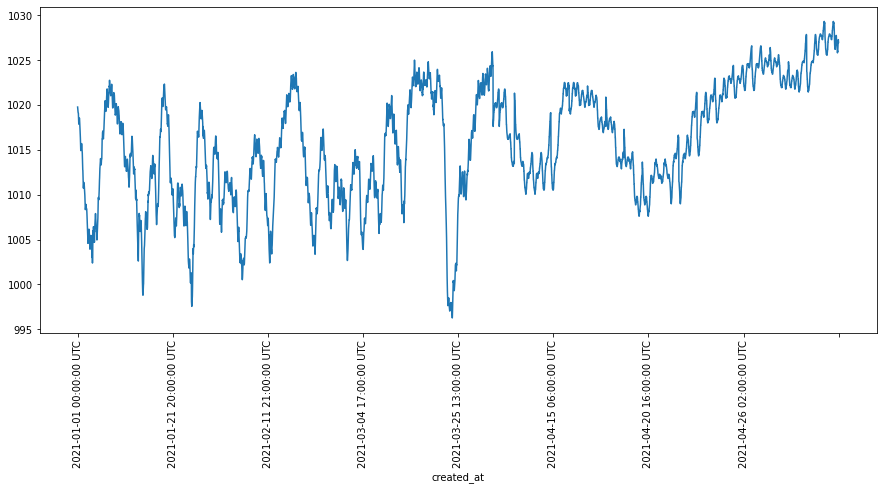

In [ ]:
a = milson_df.set_index('created_at')
a.index
y = a['Pressure_hpa']
y.plot(figsize = (15, 6))
plt.xticks(rotation=90)
plt.show()


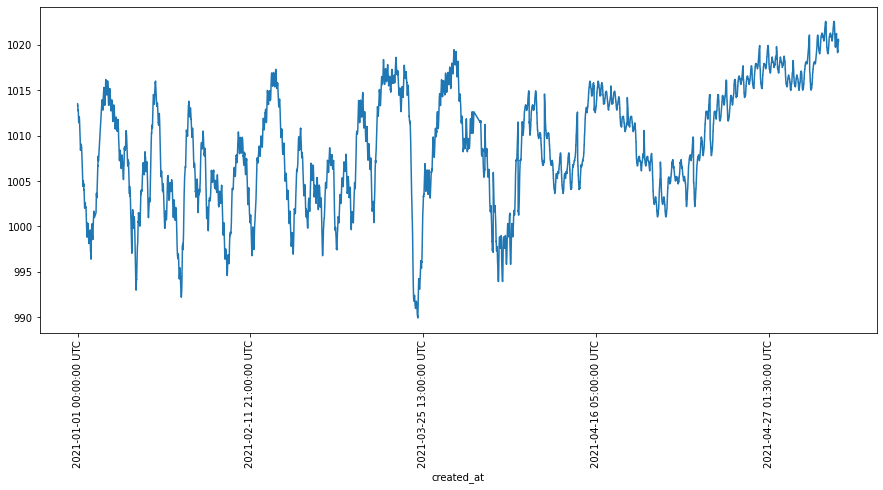

In [ ]:
a = mosman_df.set_index('created_at')
a.index
y = a['Pressure_hpa']
y.plot(figsize = (15, 6))
plt.xticks(rotation=90)
plt.show()

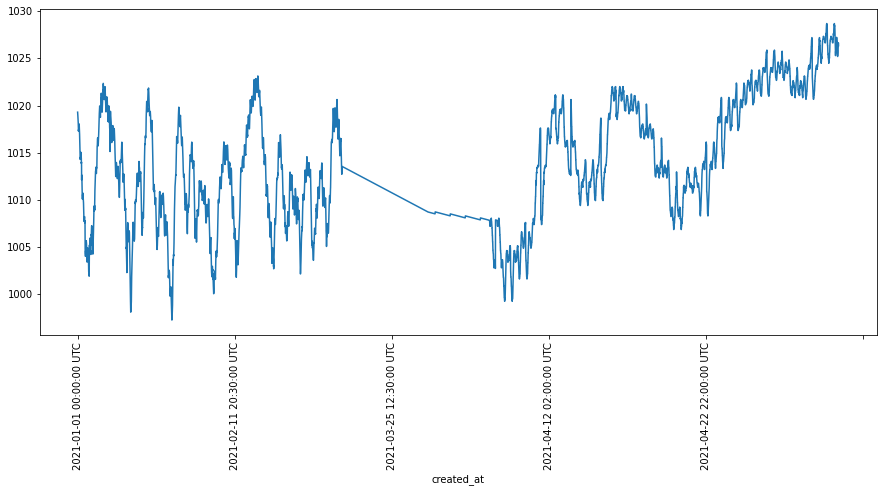

In [ ]:
a = balmain_df.set_index('created_at')
a.index
y = a['Pressure_hpa']
y.plot(figsize = (15, 6))
plt.xticks(rotation=90)
plt.show()

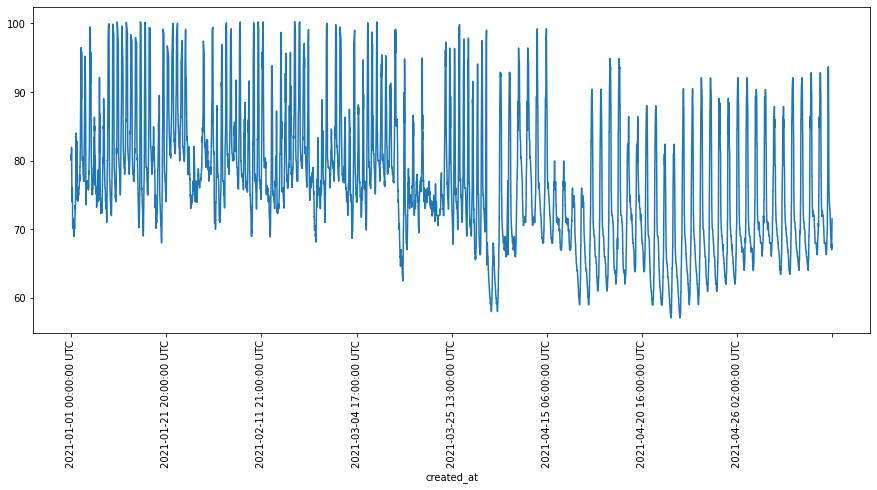

In [ ]:
f = milson_outside_df.set_index('created_at')
f.index

y = f['Temperature_F']
y

y.plot(figsize = (15, 6))
plt.xticks(rotation=90)
plt.show()

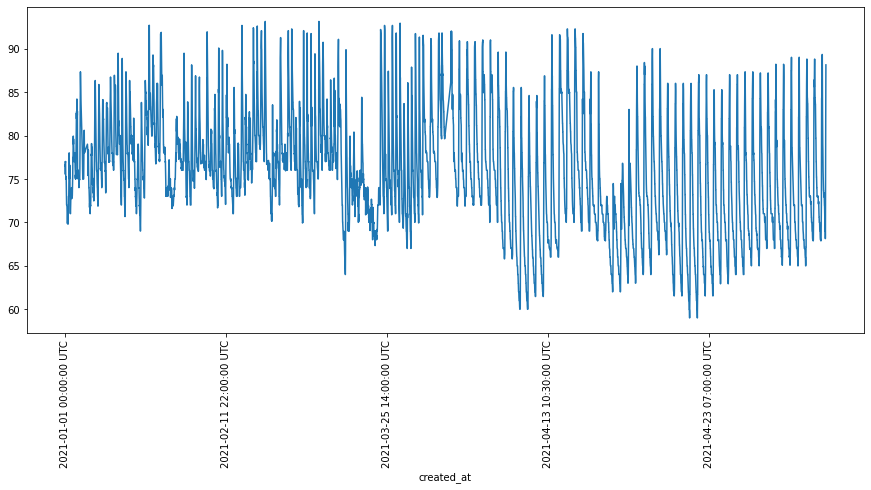

In [ ]:
f = mosman_outside_df.set_index('created_at')
f.index

y = f['Temperature_F']
y

y.plot(figsize = (15, 6))
plt.xticks(rotation=90)
plt.show()

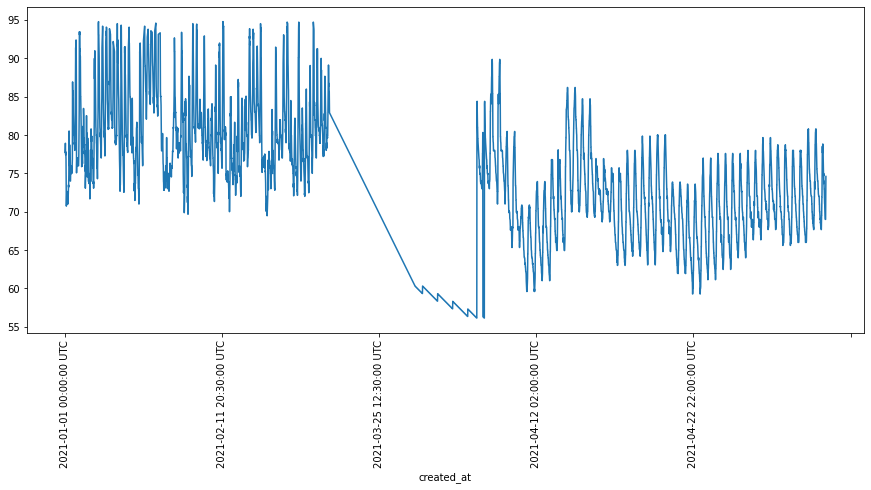

In [ ]:
f = balmain_outside_df.set_index('created_at')
f.index

y = f['Temperature_F']
y

y.plot(figsize = (15, 6))
plt.xticks(rotation=90)
plt.show()

In [ ]:
import pandas as pd
import numpy as np
import folium
import matplotlib.pyplot as plt
import seaborn as sns


import itertools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
import matplotlib
from matplotlib import rcParams

plt.style.use('fivethirtyeight')
matplotlib.rcParams['axes.labelsize'] = 14
matplotlib.rcParams['xtick.labelsize'] = 12
matplotlib.rcParams['ytick.labelsize'] = 12
matplotlib.rcParams['text.color'] = 'k'

In [ ]:
Balmain_df = pd.read_csv('Balmain_final.csv')
Balmain_df = Balmain_df.drop(['created_at.1'],axis=1)
Balmain_df['created_at']=pd.to_datetime(Balmain_df['created_at'])
# Milsons.index=(pd.DatetimeIndex(Milsons['created_at']))
num_columns=[elem for elem in list(Balmain_df.columns) if elem not in ['UptimeMinutes','created_at']]

for i in num_columns:
  q1,q3=Balmain_df[i].quantile([0.25, 0.75])
  iqr = q3 - q1
  lower = q1 - (1.5*iqr)
  upper = q3 + (1.5*iqr)
  series_outlier = ((Balmain_df[i]>upper) | (Balmain_df[i]<lower)).astype('int').tolist()
  index_outlier=[elem for elem in range (len(series_outlier)) if series_outlier[elem]==1]
  Balmain_df[i].iloc[index_outlier]=np.nan

Balmain_df.index=(pd.DatetimeIndex(Balmain_df['created_at']))

for column in num_columns:
    Balmain_df[column].interpolate('time', inplace=True)

In [ ]:
Balmain_df= Balmain_df.resample('1D').mean()
for column in num_columns:
    Balmain_df[column]=Balmain_df[column].fillna(Balmain_df[column].median())

Balmain_df.head()

,PM1.0_CF1_ug/m3,PM2.5_CF1_ug/m3,PM10.0_CF1_ug/m3,UptimeMinutes,RSSI_dbm,Temperature_F,Humidity_%,PM2.5_ATM_ug/m3,>=0.3um/dl,>=0.5um/dl,>1.0um/dl,>=2.5um/dl,>=5.0um/dl,>=10.0um/dl,PM1.0_ATM_ug/m3,PM10_ATM_ug/m3
created_at,,,,,,,,,,,,,,,,
2018-11-10 00:00:00+00:00,0.39,0.70,1.04,20.00,-57.480000,75.43,40.78,0.70,260.20,65.92,8.17,1.51,0.69,0.32,0.69,0.32
2018-11-11 00:00:00+00:00,3.59,4.74,5.41,8.11,-41.003333,80.00,44.00,4.74,908.09,231.47,22.58,2.89,1.00,0.29,3.61,5.41
2018-11-12 00:00:00+00:00,0.09,0.14,0.26,227.00,-50.580000,85.98,37.60,0.14,184.29,38.49,3.50,0.67,0.38,0.32,0.09,0.26
2018-11-13 00:00:00+00:00,2.48,2.64,2.98,279.00,-50.360000,86.18,33.33,2.64,1019.94,198.00,5.11,1.24,0.64,0.34,2.48,2.98
2018-11-14 00:00:00+00:00,2.02,3.28,4.39,614.89,-49.980000,76.89,63.11,3.28,550.78,158.95,22.40,4.26,1.64,0.51,2.01,4.36


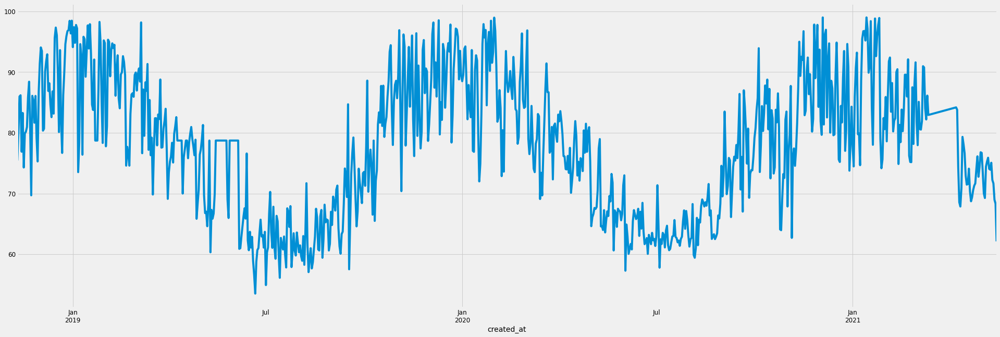

In [ ]:
import matplotlib.pyplot as plt

y = Balmain_df['Temperature_F']
y

y.plot(figsize = (30, 10))
plt.show()

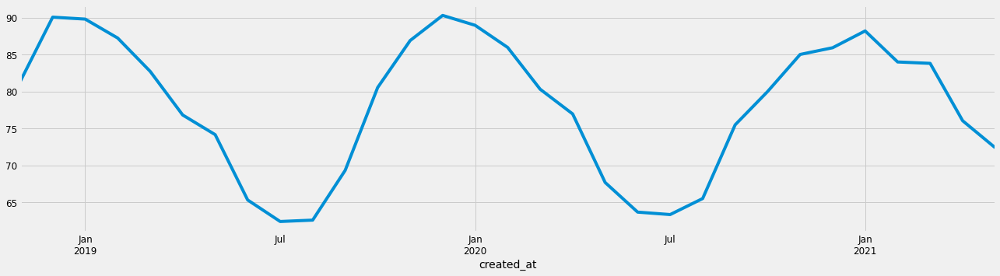

In [ ]:
y = Balmain_df['Temperature_F'].resample('MS').mean()

x = Balmain_df.index
y.plot(figsize = (20, 5))
plt.show()

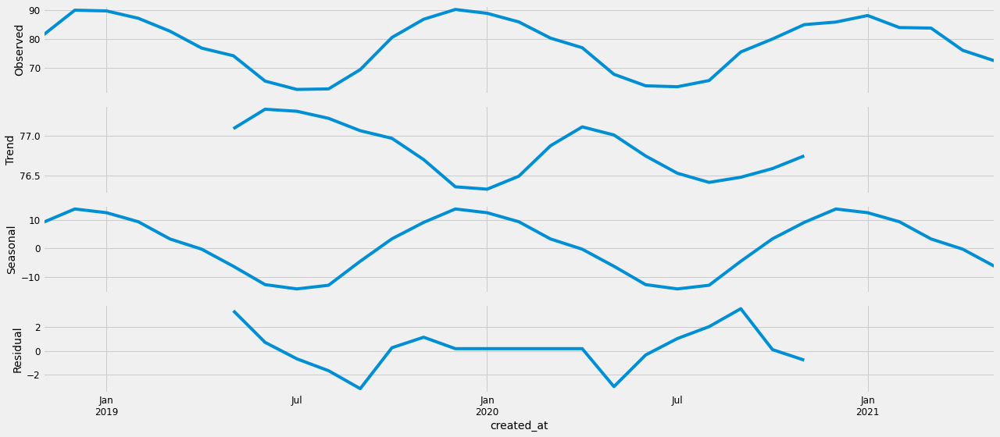

In [ ]:
Balmain_month=Balmain_df.resample('1M').mean()
from pylab import rcParams
import statsmodels.api as sm
rcParams['figure.figsize'] = 18, 8


decomposition = sm.tsa.seasonal_decompose(Balmain_month['Temperature_F'],model = 'additive')
fig = decomposition.plot()
plt.show()

In [ ]:
y=Balmain_month['Temperature_F']
p = d = q = range(0, 2)

#take all possible combination for p, d and q
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

print('Examples of parameter combinations for Seasonal ARIMA...')
for i in range(len(pdq)):
  print('SARIMAX: {} x {}'.format(pdq[i], seasonal_pdq[i]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 0) x (0, 0, 0, 12)
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 1, 0) x (0, 1, 0, 12)
SARIMAX: (0, 1, 1) x (0, 1, 1, 12)
SARIMAX: (1, 0, 0) x (1, 0, 0, 12)
SARIMAX: (1, 0, 1) x (1, 0, 1, 12)
SARIMAX: (1, 1, 0) x (1, 1, 0, 12)
SARIMAX: (1, 1, 1) x (1, 1, 1, 12)


In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y, order = param, seasonal_order = param_seasonal, enforce_stationary = False,enforce_invertibility=False) 
            result = mod.fit()   
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, result.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:360.6257072741861
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:100.02026437803679
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:240.4563024975421
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:97.98446931644271
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:324.31931944252074
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:101.58627984109683
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:241.12612335064347
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:99.7507509159266
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:187.7012698134553
ARIMA(0, 1, 0)x(0, 1, 0, 12)12 - AIC:102.08308626126443
ARIMA(0, 1, 0)x(1, 0, 0, 12)12 - AIC:176.08444985049945
ARIMA(0, 1, 0)x(1, 1, 0, 12)12 - AIC:102.42410050165583
ARIMA(0, 1, 1)x(0, 0, 0, 12)12 - AIC:181.47683491910888
ARIMA(0, 1, 1)x(0, 1, 0, 12)12 - AIC:100.77407986120818
ARIMA(0, 1, 1)x(1, 0, 0, 12)12 - AIC:177.670112669794
ARIMA(0, 1, 1)x(1, 1, 0, 12)12 - AIC:99.33751046692552
ARIMA(1, 0, 0)x(0, 0, 0, 12)12 - AIC:201.19222225676842
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:101.41856982916748
A

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:512: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:191.43308219680503
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:101.69080985025029
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:176.48456123493042
ARIMA(1, 1, 0)x(0, 1, 0, 12)12 - AIC:100.9890910162506
ARIMA(1, 1, 0)x(1, 0, 0, 12)12 - AIC:176.60874995401304
ARIMA(1, 1, 0)x(1, 1, 0, 12)12 - AIC:101.45026049123251
ARIMA(1, 1, 1)x(0, 0, 0, 12)12 - AIC:178.48023829393992
ARIMA(1, 1, 1)x(0, 1, 0, 12)12 - AIC:102.29344963543228
ARIMA(1, 1, 1)x(1, 0, 0, 12)12 - AIC:178.23460060625
ARIMA(1, 1, 1)x(1, 1, 0, 12)12 - AIC:102.76136093259363


In [ ]:
model = sm.tsa.statespace.SARIMAX(y, order = (0, 1, 0),
                                  seasonal_order = (0, 1, 0, 12)
                                 )
result = model.fit()
print(result.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2        15.2154      7.514      2.025      0.043       0.488      29.943


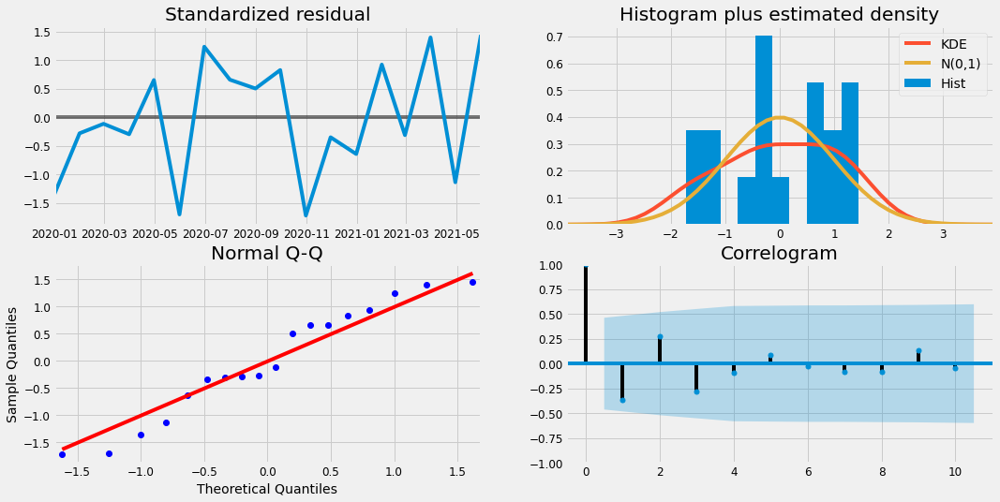

In [ ]:
result.plot_diagnostics(figsize = (16, 8))
plt.show()

In [ ]:
prediction = result.get_prediction(start = pd.to_datetime('2021-01-31 00:00:00+00:00'), dynamic = False)
prediction_ci = prediction.conf_int()
prediction_ci

,lower Temperature_F,upper Temperature_F
created_at,,
2021-01-31 00:00:00+00:00,76.926135,92.216589
2021-02-28 00:00:00+00:00,77.545233,92.835688
2021-03-31 00:00:00+00:00,70.688694,85.979148
2021-04-30 00:00:00+00:00,72.809020,88.099474
2021-05-31 00:00:00+00:00,59.118564,74.409019


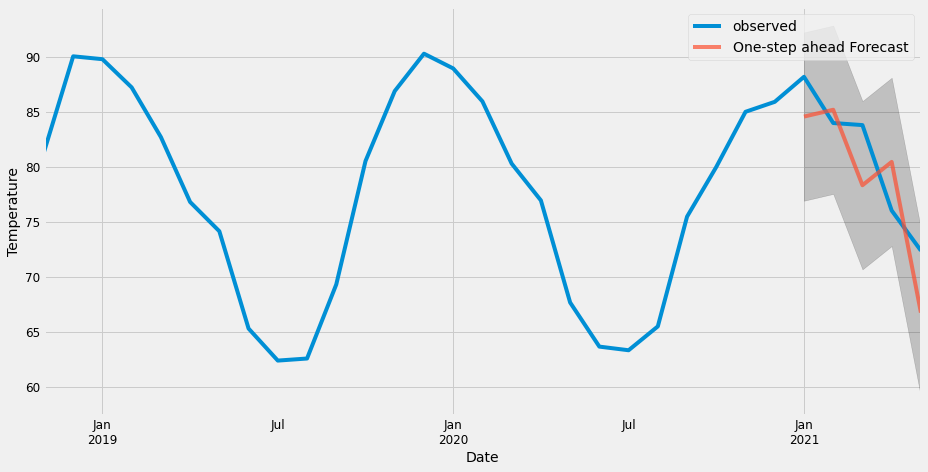

In [ ]:
ax = y['2018':].plot(label = 'observed')
prediction.predicted_mean.plot(ax = ax, label = 'One-step ahead Forecast', alpha = 0.7, figsize = (14, 7))
ax.fill_between(prediction_ci.index, prediction_ci.iloc[:, 0], prediction_ci.iloc[:, 1], color = 'k', alpha = 0.2)
ax.set_xlabel("Date")
ax.set_ylabel('Temperature')
plt.legend()
plt.show()

In [ ]:
y_hat = prediction.predicted_mean
y_truth = y['2021-01-31 00:00:00+00:00':]

mse = ((y_hat - y_truth) ** 2).mean()
rmse = np.sqrt(mse)
print('The Mean Squared Error of our forecasts is {}'.format(round(mse, 2)))
print('The Root Mean Squared Error of our forecasts is {}'.format(round(rmse, 2)))

The Mean Squared Error of our forecasts is 19.11
The Root Mean Squared Error of our forecasts is 4.37


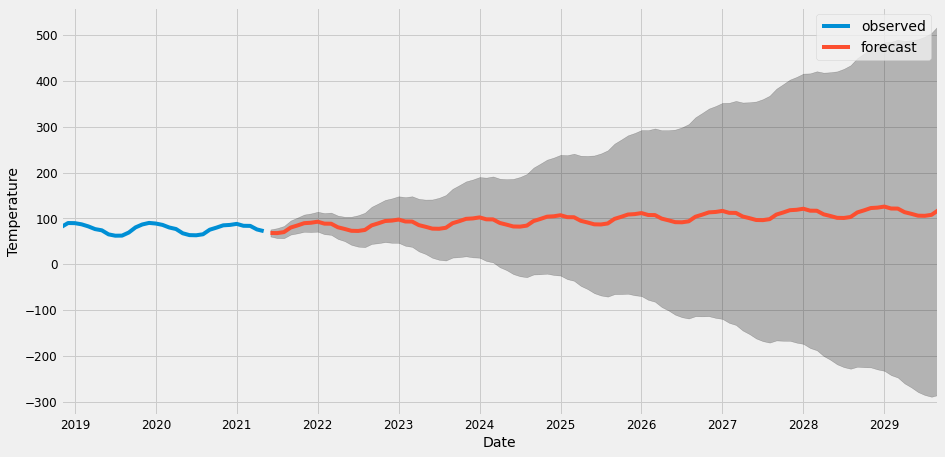

In [ ]:
pred_uc = result.get_forecast(steps = 100)
pred_ci = pred_uc.conf_int()

ax = y.plot(label = 'observed', figsize = (14, 7))
pred_uc.predicted_mean.plot(ax = ax, label = 'forecast')
ax.fill_between(pred_ci.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color = 'k', alpha = 0.25)
ax.set_xlabel('Date')
ax.set_ylabel('Temperature')

plt.legend()
plt.show()

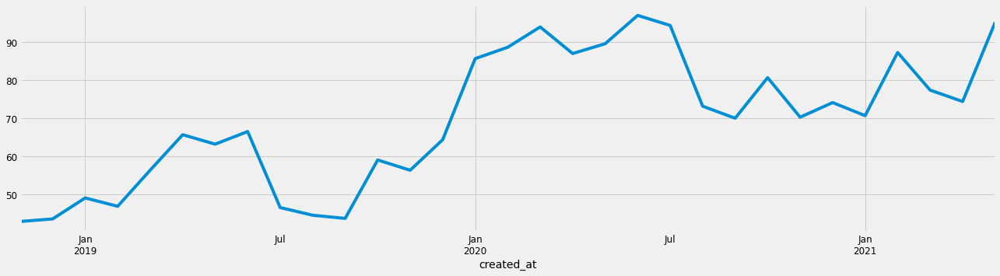

In [ ]:
y = Balmain_df['Humidity_%'].resample('MS').mean()

x = Balmain_df.index
y.plot(figsize = (20, 5))
plt.show()

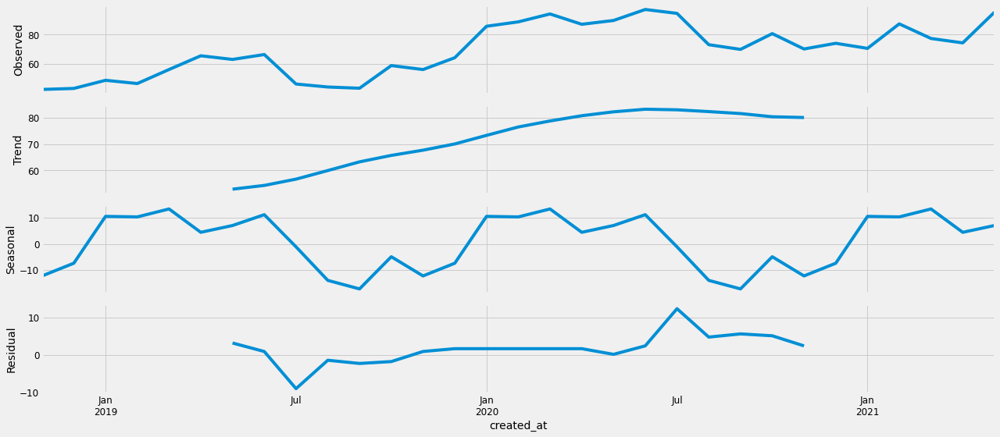

In [ ]:
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(Balmain_month['Humidity_%'],model = 'additive')
fig = decomposition.plot()
plt.show()

In [ ]:
y=Balmain_month['Humidity_%']
p = d = q = range(0, 2)

#take all possible combination for p, d and q
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

print('Examples of parameter combinations for Seasonal ARIMA...')
for i in range(len(pdq)):
  print('SARIMAX: {} x {}'.format(pdq[i], seasonal_pdq[i]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 0) x (0, 0, 0, 12)
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 1, 0) x (0, 1, 0, 12)
SARIMAX: (0, 1, 1) x (0, 1, 1, 12)
SARIMAX: (1, 0, 0) x (1, 0, 0, 12)
SARIMAX: (1, 0, 1) x (1, 0, 1, 12)
SARIMAX: (1, 1, 0) x (1, 1, 0, 12)
SARIMAX: (1, 1, 1) x (1, 1, 1, 12)


In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y, order = param, seasonal_order = param_seasonal, enforce_stationary = False,enforce_invertibility=False) 
            result = mod.fit()   
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, result.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:354.91088643302743
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:179.2066299140692
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:316.13213488717014
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:180.67671420187648
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:320.02987400343073


/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:981: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:167.57050005958155
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:289.0015983320526
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:169.07765381581135
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:226.11853332626586
ARIMA(0, 1, 0)x(0, 1, 0, 12)12 - AIC:144.03370184878494
ARIMA(0, 1, 0)x(1, 0, 0, 12)12 - AIC:227.06716139518352
ARIMA(0, 1, 0)x(1, 1, 0, 12)12 - AIC:145.62158765204296
ARIMA(0, 1, 1)x(0, 0, 0, 12)12 - AIC:227.93890842213173
ARIMA(0, 1, 1)x(0, 1, 0, 12)12 - AIC:145.68187096236596
ARIMA(0, 1, 1)x(1, 0, 0, 12)12 - AIC:228.68906821570215
ARIMA(0, 1, 1)x(1, 1, 0, 12)12 - AIC:146.88700736637344


/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


ARIMA(1, 0, 0)x(0, 0, 0, 12)12 - AIC:239.4108040116264
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:153.3806737115092
ARIMA(1, 0, 0)x(1, 0, 0, 12)12 - AIC:240.20759870177218
ARIMA(1, 0, 0)x(1, 1, 0, 12)12 - AIC:155.02964211980304
ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:241.22676524503117
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:155.2533573347162
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:241.82561051241595
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:156.61417828225822
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:227.96652117971516
ARIMA(1, 1, 0)x(0, 1, 0, 12)12 - AIC:145.66168590467964
ARIMA(1, 1, 0)x(1, 0, 0, 12)12 - AIC:228.7345532851525
ARIMA(1, 1, 0)x(1, 1, 0, 12)12 - AIC:146.94354444817074
ARIMA(1, 1, 1)x(0, 0, 0, 12)12 - AIC:229.56501634764345
ARIMA(1, 1, 1)x(0, 1, 0, 12)12 - AIC:147.62009085996678
ARIMA(1, 1, 1)x(1, 0, 0, 12)12 - AIC:230.2055190928009
ARIMA(1, 1, 1)x(1, 1, 0, 12)12 - AIC:148.87831081229652


In [ ]:
model = sm.tsa.statespace.SARIMAX(y, order = (0, 1, 0),
                                  seasonal_order = (0, 1, 0, 12)
                                 )
result = model.fit()
print(result.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2       156.4721     68.707      2.277      0.023      21.808     291.136


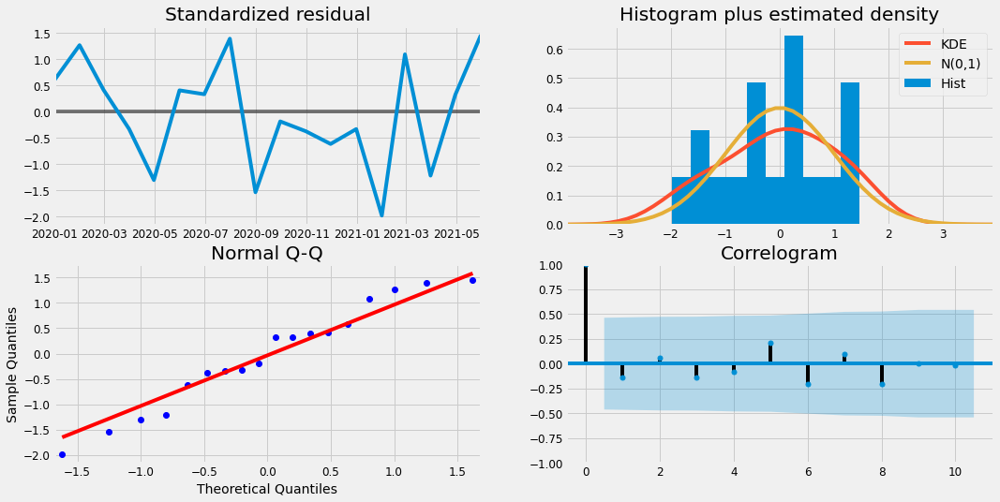

In [ ]:
result.plot_diagnostics(figsize = (16, 8))
plt.show()

In [ ]:
prediction = result.get_prediction(start = pd.to_datetime('2021-01-31 00:00:00+00:00'), dynamic = False)
prediction_ci = prediction.conf_int()
prediction_ci

,lower Humidity_%,upper Humidity_%
created_at,,
2021-01-31 00:00:00+00:00,70.983044,120.016956
2021-02-28 00:00:00+00:00,49.182043,98.215955
2021-03-31 00:00:00+00:00,68.175923,117.209835
2021-04-30 00:00:00+00:00,45.914468,94.948380
2021-05-31 00:00:00+00:00,52.500147,101.534060


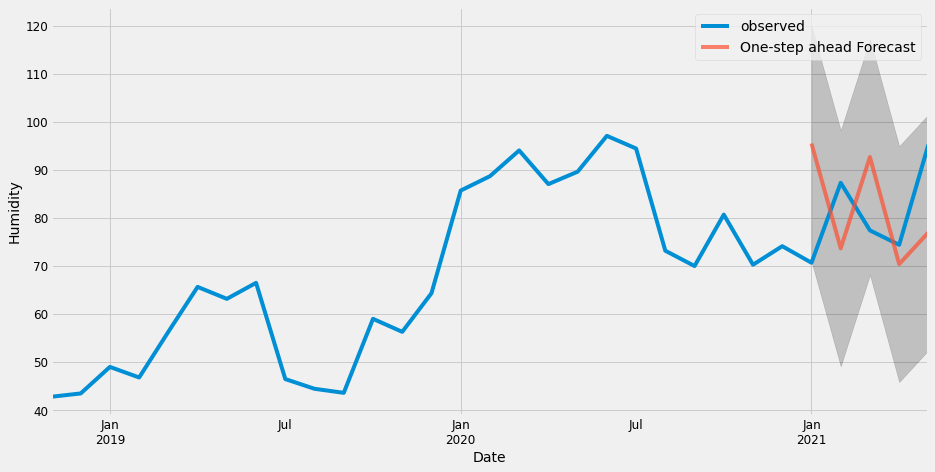

In [ ]:
ax = y['2018':].plot(label = 'observed')
prediction.predicted_mean.plot(ax = ax, label = 'One-step ahead Forecast', alpha = 0.7, figsize = (14, 7))
ax.fill_between(prediction_ci.index, prediction_ci.iloc[:, 0], prediction_ci.iloc[:, 1], color = 'k', alpha = 0.2)
ax.set_xlabel("Date")
ax.set_ylabel('Humidity')
plt.legend()
plt.show()

In [ ]:
y_hat = prediction.predicted_mean
y_truth = y['2021-01-31 00:00:00+00:00':]

mse = ((y_hat - y_truth) ** 2).mean()
rmse = np.sqrt(mse)
print('The Mean Squared Error of our forecasts is {}'.format(round(mse, 2)))
print('The Root Mean Squared Error of our forecasts is {}'.format(round(rmse, 2)))

The Mean Squared Error of our forecasts is 276.51
The Root Mean Squared Error of our forecasts is 16.63


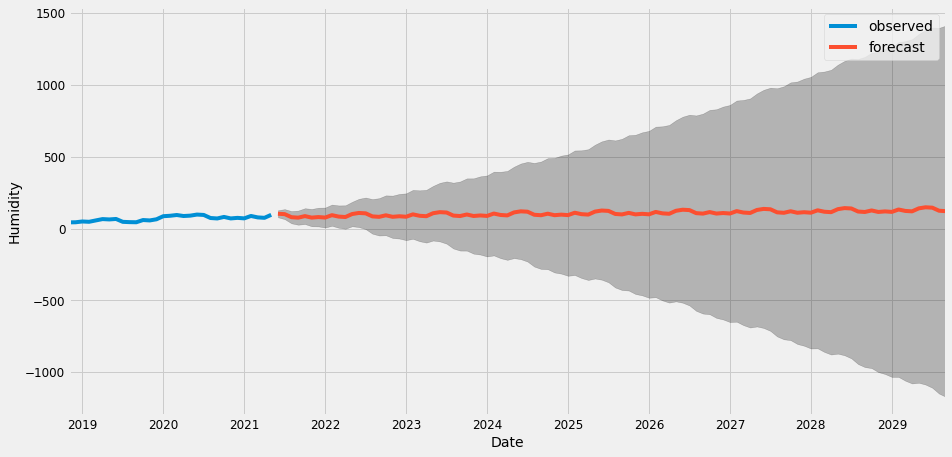

In [ ]:
pred_uc = result.get_forecast(steps = 100)
pred_ci = pred_uc.conf_int()

ax = y.plot(label = 'observed', figsize = (14, 7))
pred_uc.predicted_mean.plot(ax = ax, label = 'forecast')
ax.fill_between(pred_ci.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color = 'k', alpha = 0.25)
ax.set_xlabel('Date')
ax.set_ylabel('Humidity')

plt.legend()
plt.show()

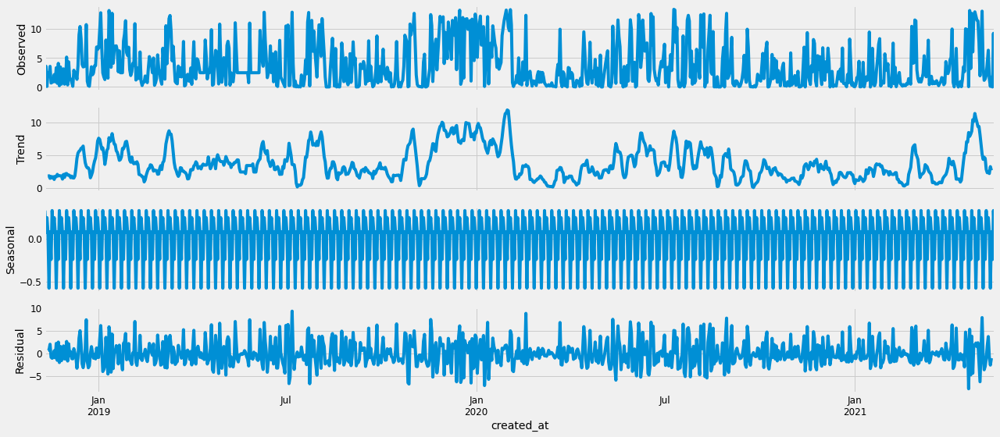

In [ ]:
Balmain_df=Balmain_df.rename(columns={'Unnamed: 0':'created_at'})
from pylab import rcParams
import statsmodels.api as sm
rcParams['figure.figsize'] = 18, 8


decomposition = sm.tsa.seasonal_decompose(Balmain_df['PM1.0_CF1_ug/m3'],model = 'additive')
fig = decomposition.plot()
plt.show()

In [ ]:
Balmain_month=Balmain_df.resample('1M').mean()
plt.style.use('fivethirtyeight')
matplotlib.rcParams['axes.labelsize'] = 14
matplotlib.rcParams['xtick.labelsize'] = 12
matplotlib.rcParams['ytick.labelsize'] = 12
matplotlib.rcParams['text.color'] = 'k'

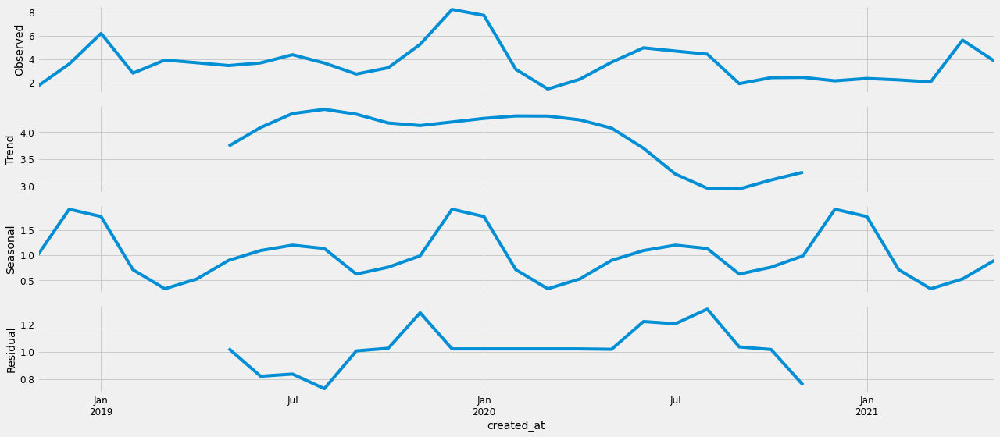

In [ ]:
rcParams['figure.figsize'] = 18, 8


decomposition = sm.tsa.seasonal_decompose(Balmain_month['PM1.0_CF1_ug/m3'],model = 'multiplicative')
fig = decomposition.plot()
plt.show()

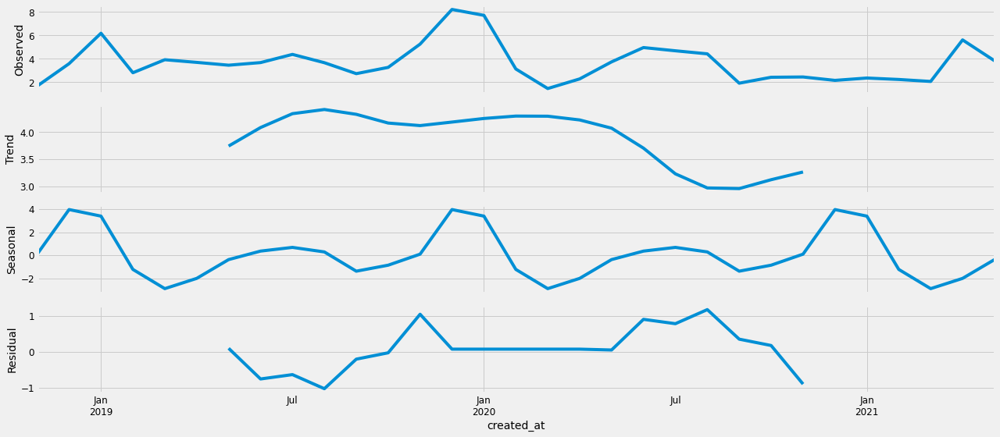

In [ ]:
rcParams['figure.figsize'] = 18, 8


decomposition = sm.tsa.seasonal_decompose(Balmain_month['PM1.0_CF1_ug/m3'],model = 'additive')
fig = decomposition.plot()
plt.show()

In [ ]:
y=Balmain_month['PM1.0_CF1_ug/m3']
p = d = q = range(0, 2)

#take all possible combination for p, d and q
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]

print('Examples of parameter combinations for Seasonal ARIMA...')
for i in range(len(pdq)):
  print('SARIMAX: {} x {}'.format(pdq[i], seasonal_pdq[i]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 0) x (0, 0, 0, 12)
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 1, 0) x (0, 1, 0, 12)
SARIMAX: (0, 1, 1) x (0, 1, 1, 12)
SARIMAX: (1, 0, 0) x (1, 0, 0, 12)
SARIMAX: (1, 0, 1) x (1, 0, 1, 12)
SARIMAX: (1, 1, 0) x (1, 1, 0, 12)
SARIMAX: (1, 1, 1) x (1, 1, 1, 12)


In [ ]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y, order = param, seasonal_order = param_seasonal, enforce_stationary = False,enforce_invertibility=False) 
            result = mod.fit()   
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, result.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:176.2856558236504
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:93.02949494610151
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:158.23559824901506
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:87.26225941847795
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:149.5528732143448


/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:981: UserWarning: Non-stationary starting seasonal autoregressive Using zeros as starting parameters.
  warn('Non-stationary starting seasonal autoregressive'


ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:85.3874366499443
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:139.45642761120337
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:84.31349631667884
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:119.73425797798485
ARIMA(0, 1, 0)x(0, 1, 0, 12)12 - AIC:80.68207858354674
ARIMA(0, 1, 0)x(1, 0, 0, 12)12 - AIC:119.61585693929193
ARIMA(0, 1, 0)x(1, 1, 0, 12)12 - AIC:81.0553612856937
ARIMA(0, 1, 1)x(0, 0, 0, 12)12 - AIC:121.72178528329542
ARIMA(0, 1, 1)x(0, 1, 0, 12)12 - AIC:82.30252817216567
ARIMA(0, 1, 1)x(1, 0, 0, 12)12 - AIC:121.56935219714398
ARIMA(0, 1, 1)x(1, 1, 0, 12)12 - AIC:83.0428526124135
ARIMA(1, 0, 0)x(0, 0, 0, 12)12 - AIC:125.49321220214098
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:84.17039431901354
ARIMA(1, 0, 0)x(1, 0, 0, 12)12 - AIC:124.43934693304077
ARIMA(1, 0, 0)x(1, 1, 0, 12)12 - AIC:82.94872269376833
ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:127.17690561117575
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:84.52421106747063
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:125.88816566894137
ARIM

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


ARIMA(1, 1, 1)x(0, 1, 0, 12)12 - AIC:83.59682791322315
ARIMA(1, 1, 1)x(1, 0, 0, 12)12 - AIC:118.10653115077828
ARIMA(1, 1, 1)x(1, 1, 0, 12)12 - AIC:83.61842372565226


In [ ]:
model = sm.tsa.statespace.SARIMAX(y, order = (0, 1, 0),
                                  seasonal_order = (0, 1, 0, 12)
                                 )
result = model.fit()
print(result.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         4.6338      1.965      2.358      0.018       0.782       8.485


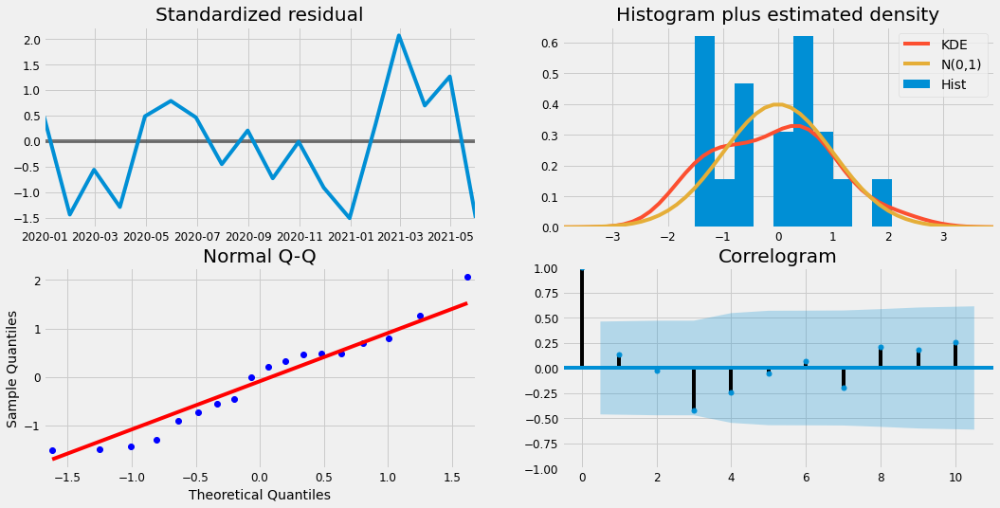

In [ ]:
result.plot_diagnostics(figsize = (16, 8))
plt.show()

In [ ]:
prediction = result.get_prediction(start = pd.to_datetime('2021-01-31 00:00:00+00:00'), dynamic = False)
prediction_ci = prediction.conf_int()
prediction_ci

,lower PM1.0_CF1_ug/m3,upper PM1.0_CF1_ug/m3
created_at,,
2021-01-31 00:00:00+00:00,-2.555816,5.882336
2021-02-28 00:00:00+00:00,-6.432686,2.005466
2021-03-31 00:00:00+00:00,-3.644448,4.793704
2021-04-30 00:00:00+00:00,-1.323893,7.114259
2021-05-31 00:00:00+00:00,2.857438,11.295589


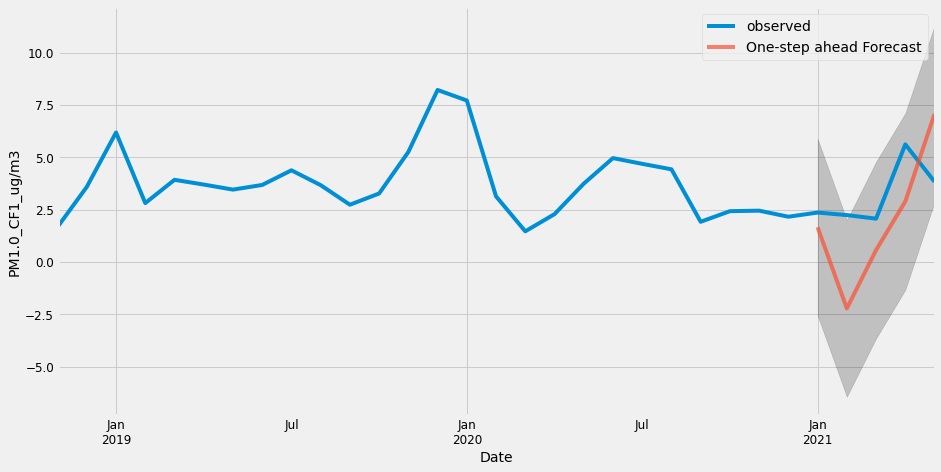

In [ ]:
ax = y['2018':].plot(label = 'observed')
prediction.predicted_mean.plot(ax = ax, label = 'One-step ahead Forecast', alpha = 0.7, figsize = (14, 7))
ax.fill_between(prediction_ci.index, prediction_ci.iloc[:, 0], prediction_ci.iloc[:, 1], color = 'k', alpha = 0.2)
ax.set_xlabel("Date")
ax.set_ylabel('PM1.0_CF1_ug/m3')
plt.legend()
plt.show()

In [ ]:
y_hat = prediction.predicted_mean
y_truth = y['2021-01-31 00:00:00+00:00':]

mse = ((y_hat - y_truth) ** 2).mean()
rmse = np.sqrt(mse)
print('The Mean Squared Error of our forecasts is {}'.format(round(mse, 2)))
print('The Root Mean Squared Error of our forecasts is {}'.format(round(rmse, 2)))

The Mean Squared Error of our forecasts is 8.1
The Root Mean Squared Error of our forecasts is 2.85


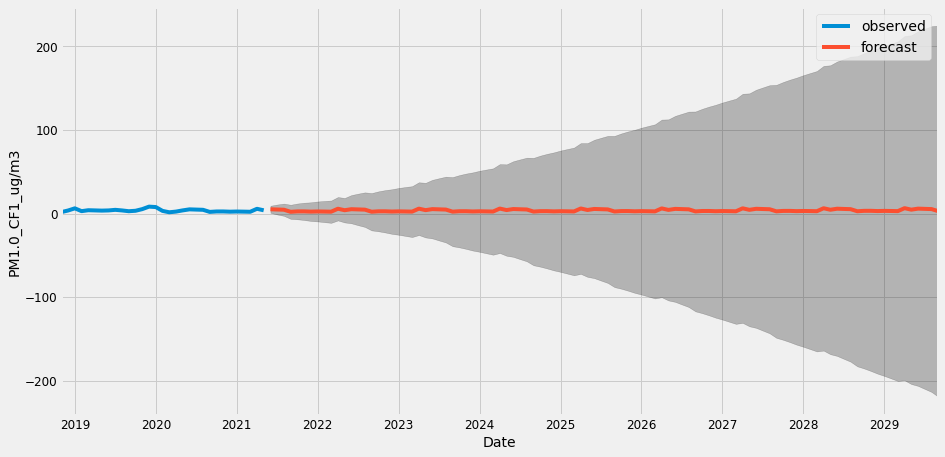

In [ ]:
pred_uc = result.get_forecast(steps = 100)
pred_ci = pred_uc.conf_int()

ax = y.plot(label = 'observed', figsize = (14, 7))
pred_uc.predicted_mean.plot(ax = ax, label = 'forecast')
ax.fill_between(pred_ci.index, pred_ci.iloc[:, 0], pred_ci.iloc[:, 1], color = 'k', alpha = 0.25)
ax.set_xlabel('Date')
ax.set_ylabel('PM1.0_CF1_ug/m3')

plt.legend()
plt.show()